In [5]:
googlecolab = True

if googlecolab:
    from os.path import exists
    from wheel.pep425tags import get_abbr_impl, get_impl_ver, get_abi_tag
    platform = '{}{}-{}'.format(get_abbr_impl(), get_impl_ver(), get_abi_tag())
    cuda_output = !ldconfig -p|grep cudart.so|sed -e 's/.*\.\([0-9]*\)\.\([0-9]*\)$/cu\1\2/'
    accelerator = cuda_output[0] if exists('/dev/nvidia0') else 'cpu'

    !pip install torchvision torch
    !pip install Pillow==4.1.1

In [0]:
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

## Hyperpameters

Define the hyperparameters. You can play with those later.

In [7]:
## Data loading

workers = 0 # Number of workers for dataloader (/!\ set to 4 when you're done debugging)

## Architecture

nz = 100 # Size of z latent vector (i.e. size of generator input)
ndf = 32 # Base size of feature maps in discriminator
ngf = 32 # Base size of feature maps in generator

## Optimization

lrD = 0.0002 # Learning rate for the discriminator
lrG = 0.0002 # Learning rate for the generator
beta1G = 0.5 # Momentum beta1 for the discriminator
beta1D = 0.5 # Momentum beta1 for the generator

## Training

batch_size = 256 # Images per batch
nb_update_D = 1 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 1 # Number of sub-steps of generator optim. at each step
steps = 8000 # Number of global steps in the training loop
nb_epochs = None # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 202000)
else:
    steps = int(nb_epochs * nb_update_D * 202000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))

Doing 10.1 epochs in 8000 steps


# Dataset

Download and load the dataset. Nothing to do here.

In [8]:
%%sh
# Dataset loading

if ! [ -d "/tmp/celeba/img_align_celeba" ] ; then
    mkdir /tmp/celeba
    cd /tmp/celeba
    wget http://webia.lip6.fr/~robert/cours/rdfia/celeba.zip
    unzip celeba.zip
fi

# For 64x64 images, replace celeba with celeba64 everywhere

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

--2019-12-11 15:33:55--  http://webia.lip6.fr/~robert/cours/rdfia/celeba.zip
Resolving webia.lip6.fr (webia.lip6.fr)... 132.227.201.33
Connecting to webia.lip6.fr (webia.lip6.fr)|132.227.201.33|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 153357646 (146M) [application/zip]
Saving to: ‘celeba.zip’

     0K .......... .......... .......... .......... ..........  0% 1.96M 75s
    50K .......... .......... .......... .......... ..........  0% 3.93M 56s
   100K .......... .......... .......... .......... ..........  0%  115M 38s
   150K .......... .......... .......... .......... ..........  0%  118M 29s
   200K .......... .......... .......

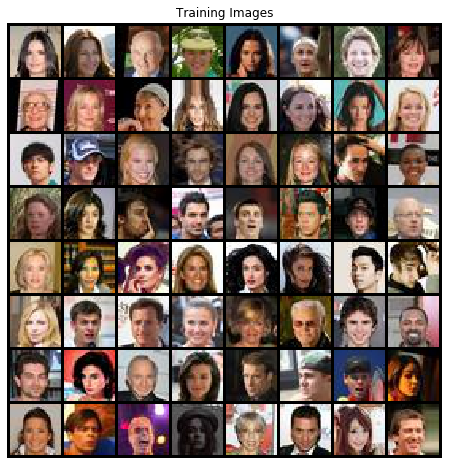

In [10]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root="/tmp/celeba",
                           transform=transforms.Compose([
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Model architectures

## Discriminator

Input: Image $x \in \mathbb{R}^{32\times 32\times 3}$  
Output: "Real" image probability $\in [0,1]$

* Convolution (`1*ndf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* LeakyReLU ($\alpha = 0.2$)
* Convolution (`2*ndf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* LeakyReLU ($\alpha = 0.2$)
* Convolution (`4*ndf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* LeakyReLU ($\alpha = 0.2$)
* Convolution (1 filter, kernel 4, stride 1, padding 0, no bias)
* Sigmoid activation

## Generator

Input: Random "noise" $z \in \mathbb{R}^{\text{nz}}$  
Output: Generated image $\tilde x \in \mathbb{R}^{32\times 32\times 3}$

* Convolution Transpose (`4*ngf` filters, kernel 4, stride 1, padding 0, no bias)
* Batch Norm 2D
* ReLU
* Convolution Transpose (`2*ngf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* ReLU
* Convolution Transpose (`1*ngf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* ReLU
* Convolution Transpose (3 filters, kernel 4, stride 2, padding 1, no bias)
* Tanh activation

In [0]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 32,4, stride=2, padding=1),
            nn.BatchNorm2d(32),                             
            nn.LeakyReLU(negative_slope=0.02),
            nn.Conv2d(32, 64, 4, stride=2, padding=1),
            nn.BatchNorm2d(64),                             
            nn.LeakyReLU(negative_slope=0.02),
            nn.Conv2d(64, 128, 4, stride=2, padding=1),
            nn.BatchNorm2d(128),                             
            nn.LeakyReLU(negative_slope=0.02),
            nn.Conv2d(128, 1,4, stride=1, padding=0),
            nn.Sigmoid()
      
        )

    def forward(self, input):
        return self.model(input)


class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 128,4, stride=1, padding=0),
            nn.BatchNorm2d(128),                             
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
            nn.BatchNorm2d(64),                             
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, 4, stride=2, padding=1),
            nn.BatchNorm2d(32),                             
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3,4, stride=2, padding=1),
            nn.Tanh()
      
        )

    def forward(self, input):
        return self.model(input)

In [19]:
# Create the models
netG = Generator().to(device)
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
netG.apply(weights_init)
netD.apply(weights_init)

# Print the models
print(netG)
print(netD)

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 128, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): Tanh()
  )
)
Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.02)
    (3): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), paddi

In [20]:
# TODO test you models to check if they have the right shape
z = torch.zeros(10, nz, 1, 1).to(device)
x = torch.zeros(10, 3, 32, 32).to(device)
print(netG(z).shape) # expected: [10, 3, 32, 32]
print(netD(x).shape) # expected: [10, 1, 1, 1]

torch.Size([10, 3, 32, 32])
torch.Size([10, 1, 1, 1])


# Optimization and training

Here we will define:
* Our prior $P(z)$ that we use to sample random "noise". We will use a Gaussian distribution.
* The criterion that will be used to train the discriminator, and indirectly the generator. We will use the binary cross-entropy.
* The optimizers of both models. We will use the Adam optimizer.

In [0]:

# Prior P(z). Returns a Gaussian random tensor of shape (batch_size, nz, 1, 1)
def get_noise(batch_size):
    noise =torch.normal(mean=0,std=1,size=(batch_size, nz, 1, 1))
    return noise.to(device)

# Create the criterion function that will take (y_hat, y) as input
criterion = nn.BCELoss()

# Setup Adam optimizers for D and G
optimizerD = torch.optim.Adam(netD.parameters(),betas=(beta1D, .999),lr=lrD) # TODO, take netD.parameters(), use the right lr and beta1
optimizerG = torch.optim.Adam(netG.parameters(),betas=(beta1G, .999),lr=lrG) # TODO, same for G
# Note that adam's betas is a tuple, set the second element of the tuple to 0.999 for both optimizers.

### Data format / batch creation functions

In [0]:
# Data format / batch creation functions

fixed_noise = get_noise(196) # Create a fixed random vector sampled from a Gaussian, will be used during train for viz
real_label = 1
fake_label = 0
iterator = iter(dataloader)

# returns a batch of real images from the dataset (iterates infinitely on the dataset)
def get_batch_real():
    global iterator
    try:
        x_real = next(iterator)[0].to(device)
    except:
        iterator = iter(dataloader)
        x_real = next(iterator)[0].to(device)
    y_real = torch.full((x_real.size(0),), real_label, device=device)
    return x_real, y_real

# TODO
# returns a batch of generated images and training targets y_fake
# Note that the targets y_fake will be different is train_G is True or False
def get_batch_fake(train_G=False):
    z = get_noise(batch_size)
    x_fake = netG(z)# TODO generate images from z
    y_fake = torch.zeros(batch_size) # TODO create targets, depends on train_G
    return x_fake.to(device), y_fake.to(device)

### Training Loop

**Reminder:** when your training loop starts to work, change the `workers` variable to 4 and rerun your notebook

In [0]:
img_list = []
G_losses = []
D_losses = []

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([256])) that is different to the input size (torch.Size([256, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


[    0/ 8000]	Loss_D: 0.7413	Loss_G: 1.0410	D(x): 0.5622	D(G(z)): 0.0715


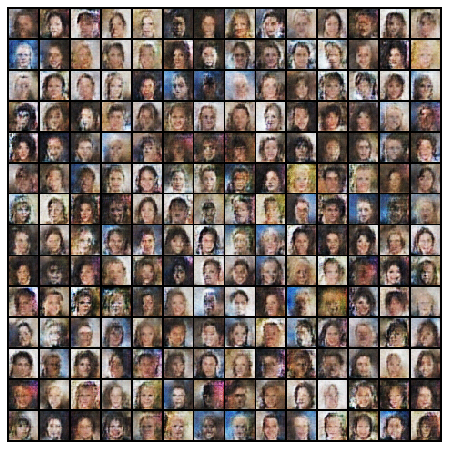

[   25/ 8000]	Loss_D: 0.5361	Loss_G: 2.5445	D(x): 0.8253	D(G(z)): 0.2663
[   50/ 8000]	Loss_D: 0.6723	Loss_G: 2.7851	D(x): 0.8796	D(G(z)): 0.3859
[   75/ 8000]	Loss_D: 0.7951	Loss_G: 0.9195	D(x): 0.5863	D(G(z)): 0.1757
[  100/ 8000]	Loss_D: 0.6695	Loss_G: 1.9237	D(x): 0.7694	D(G(z)): 0.3017


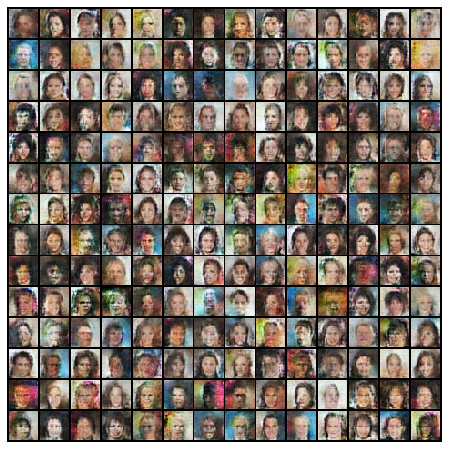

[  125/ 8000]	Loss_D: 1.3343	Loss_G: 3.5092	D(x): 0.8962	D(G(z)): 0.6556
[  150/ 8000]	Loss_D: 0.4934	Loss_G: 2.4667	D(x): 0.8463	D(G(z)): 0.2558
[  175/ 8000]	Loss_D: 0.8225	Loss_G: 2.1321	D(x): 0.7805	D(G(z)): 0.3887
[  200/ 8000]	Loss_D: 0.6229	Loss_G: 1.7358	D(x): 0.7254	D(G(z)): 0.2239


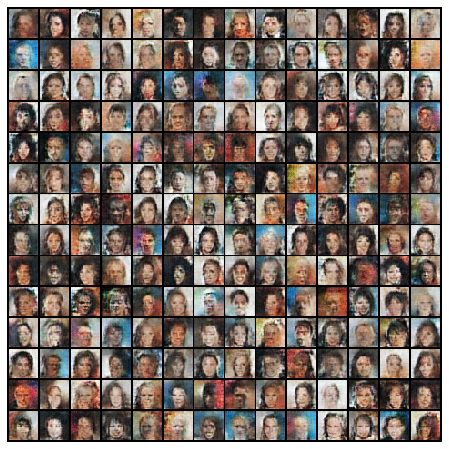

[  225/ 8000]	Loss_D: 0.5558	Loss_G: 1.7167	D(x): 0.7465	D(G(z)): 0.2025
[  250/ 8000]	Loss_D: 0.6613	Loss_G: 1.7105	D(x): 0.6744	D(G(z)): 0.1893
[  275/ 8000]	Loss_D: 0.8966	Loss_G: 3.1757	D(x): 0.9133	D(G(z)): 0.5142
[  300/ 8000]	Loss_D: 0.6521	Loss_G: 1.9934	D(x): 0.7589	D(G(z)): 0.2788


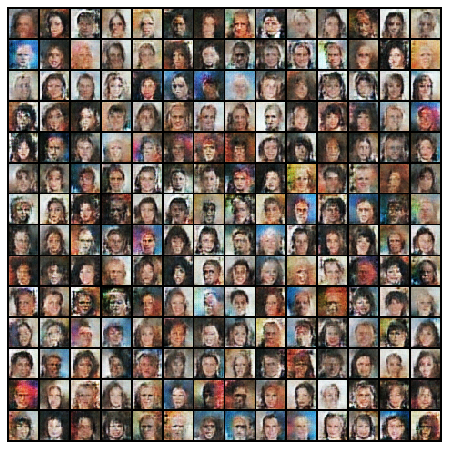

[  325/ 8000]	Loss_D: 0.6671	Loss_G: 1.2180	D(x): 0.6137	D(G(z)): 0.1065
[  350/ 8000]	Loss_D: 0.9719	Loss_G: 1.4720	D(x): 0.6868	D(G(z)): 0.4006
[  375/ 8000]	Loss_D: 0.6510	Loss_G: 2.1553	D(x): 0.7801	D(G(z)): 0.2970
[  400/ 8000]	Loss_D: 0.5497	Loss_G: 2.0457	D(x): 0.7805	D(G(z)): 0.2349


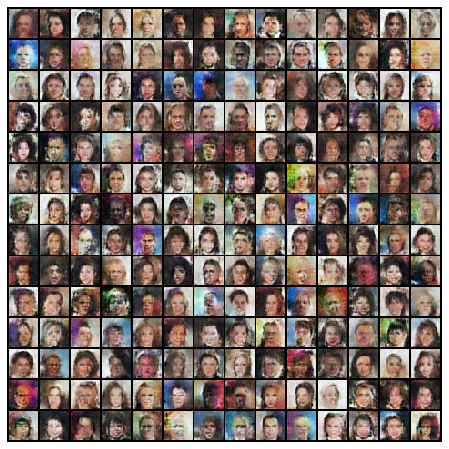

[  425/ 8000]	Loss_D: 0.5436	Loss_G: 1.7223	D(x): 0.7401	D(G(z)): 0.1842
[  450/ 8000]	Loss_D: 0.6578	Loss_G: 1.9392	D(x): 0.7366	D(G(z)): 0.2554
[  475/ 8000]	Loss_D: 0.4914	Loss_G: 1.9181	D(x): 0.7849	D(G(z)): 0.1972
[  500/ 8000]	Loss_D: 0.6426	Loss_G: 1.0767	D(x): 0.6491	D(G(z)): 0.1400


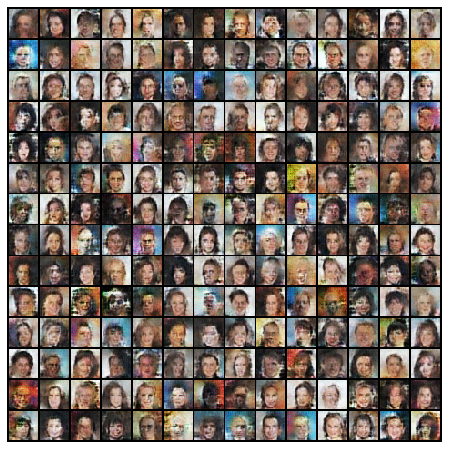

[  525/ 8000]	Loss_D: 0.6130	Loss_G: 2.2426	D(x): 0.7861	D(G(z)): 0.2781
[  550/ 8000]	Loss_D: 0.5529	Loss_G: 1.8937	D(x): 0.7400	D(G(z)): 0.1909
[  575/ 8000]	Loss_D: 0.5556	Loss_G: 2.7550	D(x): 0.8202	D(G(z)): 0.2726
[  600/ 8000]	Loss_D: 0.8125	Loss_G: 3.2674	D(x): 0.8328	D(G(z)): 0.4206


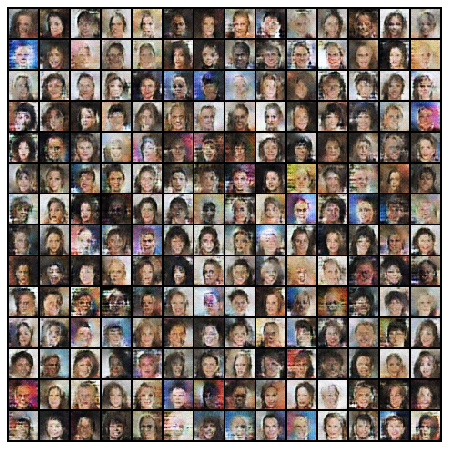

[  625/ 8000]	Loss_D: 0.6097	Loss_G: 2.5883	D(x): 0.8316	D(G(z)): 0.3198
[  650/ 8000]	Loss_D: 0.5015	Loss_G: 2.0806	D(x): 0.7923	D(G(z)): 0.2100
[  675/ 8000]	Loss_D: 0.6085	Loss_G: 2.7502	D(x): 0.8535	D(G(z)): 0.3366
[  700/ 8000]	Loss_D: 0.5693	Loss_G: 2.2031	D(x): 0.7995	D(G(z)): 0.2661


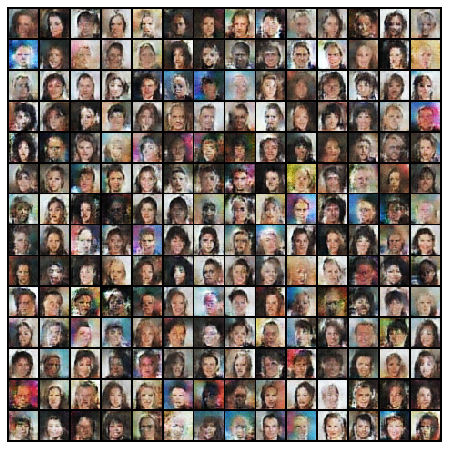

[  725/ 8000]	Loss_D: 0.5045	Loss_G: 2.4246	D(x): 0.8556	D(G(z)): 0.2758
[  750/ 8000]	Loss_D: 1.0997	Loss_G: 1.8852	D(x): 0.7154	D(G(z)): 0.4842
[  775/ 8000]	Loss_D: 0.9796	Loss_G: 0.9070	D(x): 0.5187	D(G(z)): 0.1830


/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([103])) that is different to the input size (torch.Size([103, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


[  800/ 8000]	Loss_D: 0.7017	Loss_G: 1.3266	D(x): 0.6311	D(G(z)): 0.1613


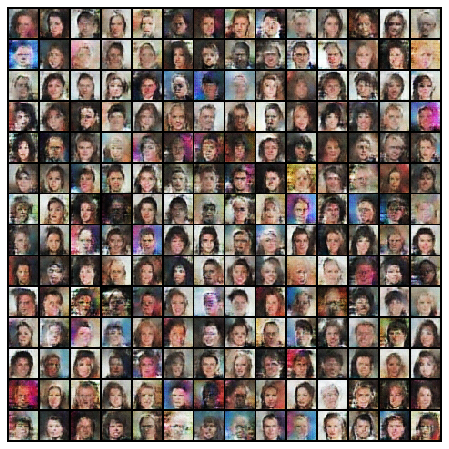

[  825/ 8000]	Loss_D: 0.8330	Loss_G: 1.5756	D(x): 0.5813	D(G(z)): 0.1712
[  850/ 8000]	Loss_D: 1.0459	Loss_G: 0.6874	D(x): 0.4539	D(G(z)): 0.1079
[  875/ 8000]	Loss_D: 0.6720	Loss_G: 1.3726	D(x): 0.6809	D(G(z)): 0.2078
[  900/ 8000]	Loss_D: 0.6657	Loss_G: 2.4175	D(x): 0.8233	D(G(z)): 0.3398


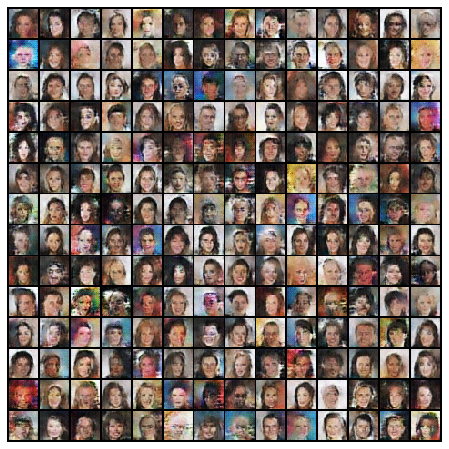

[  925/ 8000]	Loss_D: 0.6893	Loss_G: 2.4720	D(x): 0.8328	D(G(z)): 0.3655
[  950/ 8000]	Loss_D: 1.0640	Loss_G: 3.4016	D(x): 0.8998	D(G(z)): 0.5653
[  975/ 8000]	Loss_D: 0.5463	Loss_G: 2.5405	D(x): 0.8624	D(G(z)): 0.3025
[ 1000/ 8000]	Loss_D: 0.6537	Loss_G: 1.5733	D(x): 0.7624	D(G(z)): 0.2781


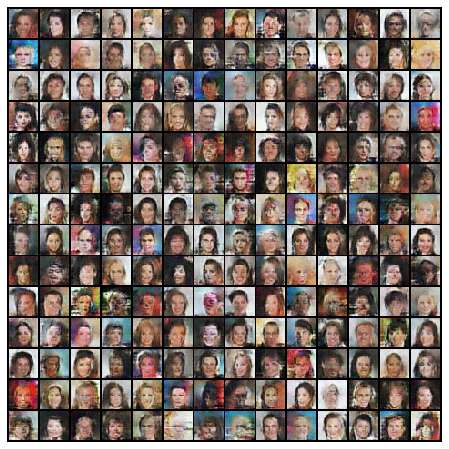

[ 1025/ 8000]	Loss_D: 1.0595	Loss_G: 1.3600	D(x): 0.4330	D(G(z)): 0.0903
[ 1050/ 8000]	Loss_D: 0.7776	Loss_G: 2.4777	D(x): 0.8698	D(G(z)): 0.4345
[ 1075/ 8000]	Loss_D: 0.6543	Loss_G: 1.3419	D(x): 0.6345	D(G(z)): 0.1251
[ 1100/ 8000]	Loss_D: 0.6714	Loss_G: 1.4674	D(x): 0.6717	D(G(z)): 0.1977


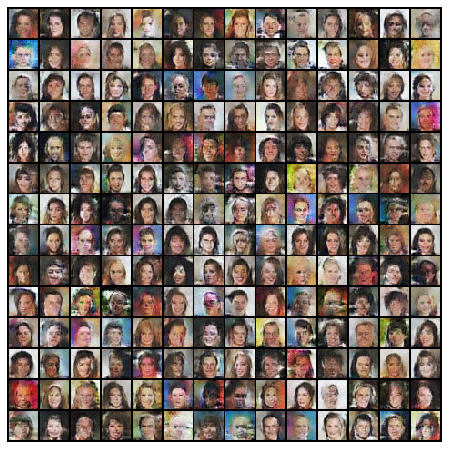

[ 1125/ 8000]	Loss_D: 0.5609	Loss_G: 1.5414	D(x): 0.7082	D(G(z)): 0.1563
[ 1150/ 8000]	Loss_D: 0.5526	Loss_G: 1.6006	D(x): 0.7428	D(G(z)): 0.1943
[ 1175/ 8000]	Loss_D: 0.7288	Loss_G: 1.5692	D(x): 0.7171	D(G(z)): 0.2864
[ 1200/ 8000]	Loss_D: 0.5849	Loss_G: 2.8999	D(x): 0.8540	D(G(z)): 0.3208


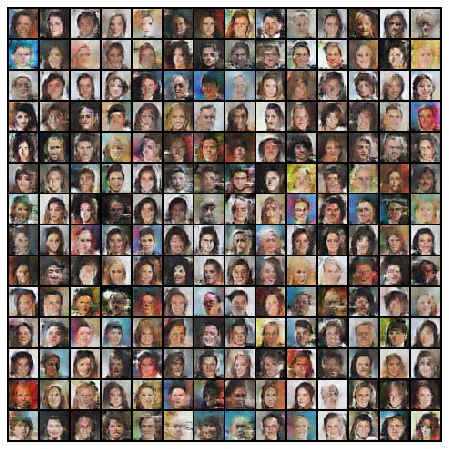

[ 1225/ 8000]	Loss_D: 0.6352	Loss_G: 1.6349	D(x): 0.6632	D(G(z)): 0.1468
[ 1250/ 8000]	Loss_D: 1.8145	Loss_G: 0.2893	D(x): 0.2197	D(G(z)): 0.0472
[ 1275/ 8000]	Loss_D: 0.5445	Loss_G: 1.4834	D(x): 0.7521	D(G(z)): 0.1956
[ 1300/ 8000]	Loss_D: 0.6074	Loss_G: 1.7090	D(x): 0.7317	D(G(z)): 0.2220


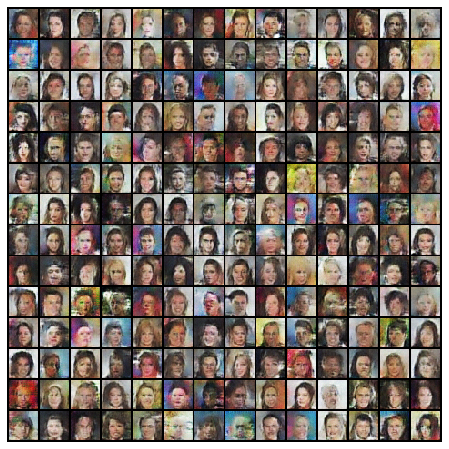

[ 1325/ 8000]	Loss_D: 0.6305	Loss_G: 1.6130	D(x): 0.7024	D(G(z)): 0.2071
[ 1350/ 8000]	Loss_D: 0.5664	Loss_G: 2.1015	D(x): 0.7939	D(G(z)): 0.2559
[ 1375/ 8000]	Loss_D: 0.9994	Loss_G: 1.0702	D(x): 0.4508	D(G(z)): 0.0786
[ 1400/ 8000]	Loss_D: 1.1362	Loss_G: 2.3929	D(x): 0.9175	D(G(z)): 0.6044


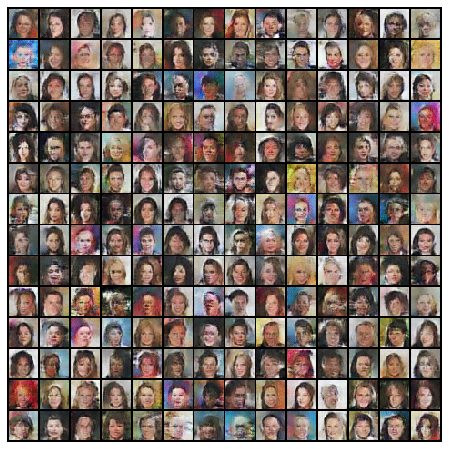

[ 1425/ 8000]	Loss_D: 0.9211	Loss_G: 0.9226	D(x): 0.4933	D(G(z)): 0.1118
[ 1450/ 8000]	Loss_D: 0.6318	Loss_G: 1.5063	D(x): 0.7110	D(G(z)): 0.2158
[ 1475/ 8000]	Loss_D: 0.6665	Loss_G: 1.8628	D(x): 0.7486	D(G(z)): 0.2807
[ 1500/ 8000]	Loss_D: 0.8037	Loss_G: 1.4154	D(x): 0.6995	D(G(z)): 0.3150


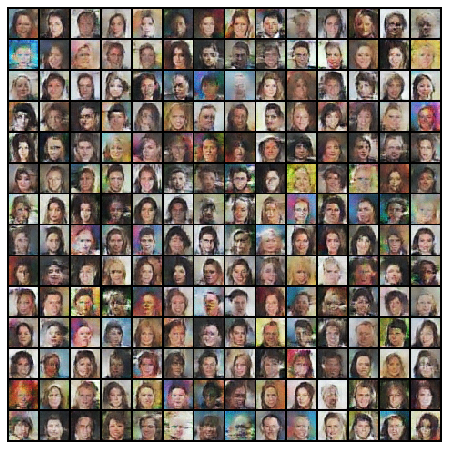

[ 1525/ 8000]	Loss_D: 0.5798	Loss_G: 2.0765	D(x): 0.8046	D(G(z)): 0.2792
[ 1550/ 8000]	Loss_D: 0.6666	Loss_G: 2.5324	D(x): 0.8850	D(G(z)): 0.3915
[ 1575/ 8000]	Loss_D: 0.6461	Loss_G: 2.2089	D(x): 0.7912	D(G(z)): 0.3104
[ 1600/ 8000]	Loss_D: 0.9426	Loss_G: 2.3157	D(x): 0.9248	D(G(z)): 0.5430


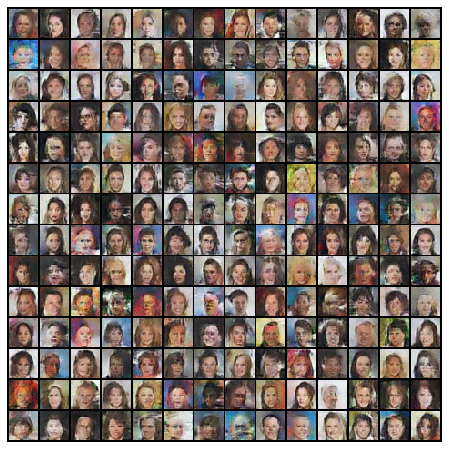

[ 1625/ 8000]	Loss_D: 0.6003	Loss_G: 1.6074	D(x): 0.7280	D(G(z)): 0.2141
[ 1650/ 8000]	Loss_D: 0.5941	Loss_G: 2.1016	D(x): 0.8375	D(G(z)): 0.3127
[ 1675/ 8000]	Loss_D: 0.6533	Loss_G: 2.6040	D(x): 0.8767	D(G(z)): 0.3777
[ 1700/ 8000]	Loss_D: 0.6466	Loss_G: 1.6695	D(x): 0.7413	D(G(z)): 0.2626


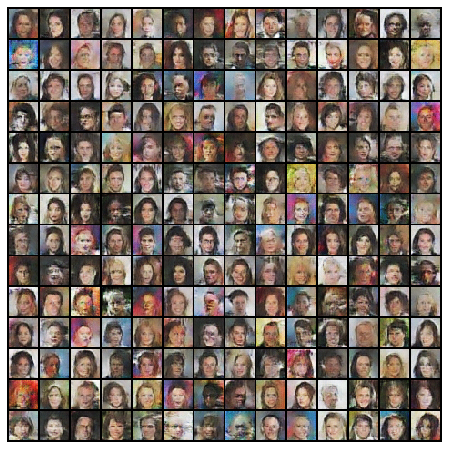

[ 1725/ 8000]	Loss_D: 0.5778	Loss_G: 1.8719	D(x): 0.7307	D(G(z)): 0.2009
[ 1750/ 8000]	Loss_D: 0.5917	Loss_G: 1.3668	D(x): 0.7078	D(G(z)): 0.1840
[ 1775/ 8000]	Loss_D: 0.8971	Loss_G: 2.5354	D(x): 0.8970	D(G(z)): 0.5093
[ 1800/ 8000]	Loss_D: 0.8546	Loss_G: 0.8900	D(x): 0.5219	D(G(z)): 0.1065


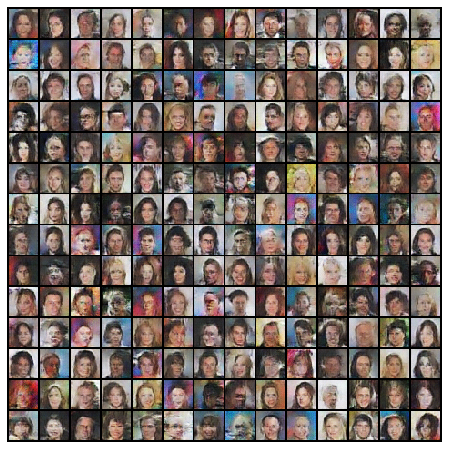

[ 1825/ 8000]	Loss_D: 0.6143	Loss_G: 2.2170	D(x): 0.7766	D(G(z)): 0.2719
[ 1850/ 8000]	Loss_D: 0.6175	Loss_G: 1.1288	D(x): 0.7038	D(G(z)): 0.2008
[ 1875/ 8000]	Loss_D: 0.6095	Loss_G: 1.2336	D(x): 0.6653	D(G(z)): 0.1420
[ 1900/ 8000]	Loss_D: 0.7332	Loss_G: 1.3770	D(x): 0.6443	D(G(z)): 0.2062


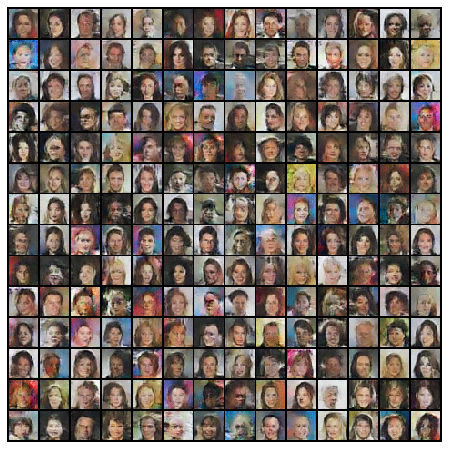

[ 1925/ 8000]	Loss_D: 0.8501	Loss_G: 1.1048	D(x): 0.5389	D(G(z)): 0.1258
[ 1950/ 8000]	Loss_D: 0.5894	Loss_G: 1.6422	D(x): 0.7548	D(G(z)): 0.2349
[ 1975/ 8000]	Loss_D: 0.5477	Loss_G: 1.2337	D(x): 0.7356	D(G(z)): 0.1871
[ 2000/ 8000]	Loss_D: 0.9039	Loss_G: 2.4255	D(x): 0.9012	D(G(z)): 0.5140


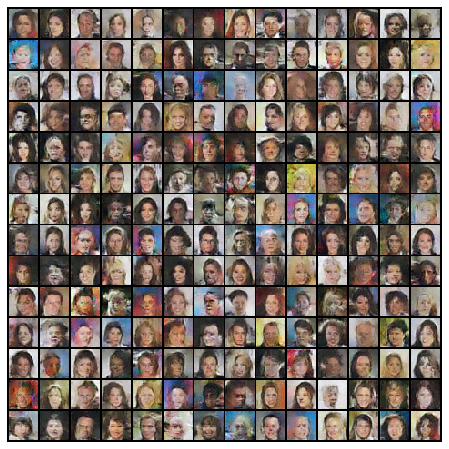

[ 2025/ 8000]	Loss_D: 0.6218	Loss_G: 1.5709	D(x): 0.7232	D(G(z)): 0.2260
[ 2050/ 8000]	Loss_D: 0.7697	Loss_G: 1.2915	D(x): 0.7224	D(G(z)): 0.3126
[ 2075/ 8000]	Loss_D: 0.6249	Loss_G: 1.9040	D(x): 0.7765	D(G(z)): 0.2807
[ 2100/ 8000]	Loss_D: 0.5973	Loss_G: 1.7808	D(x): 0.7583	D(G(z)): 0.2445


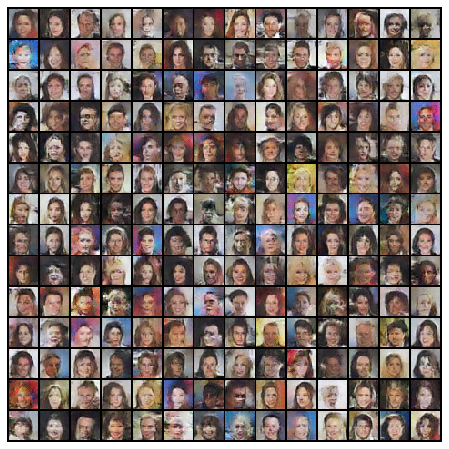

[ 2125/ 8000]	Loss_D: 0.6973	Loss_G: 1.9602	D(x): 0.8753	D(G(z)): 0.3999
[ 2150/ 8000]	Loss_D: 0.7640	Loss_G: 1.9909	D(x): 0.8650	D(G(z)): 0.4233
[ 2175/ 8000]	Loss_D: 0.5414	Loss_G: 2.3573	D(x): 0.8221	D(G(z)): 0.2685
[ 2200/ 8000]	Loss_D: 0.6292	Loss_G: 1.9567	D(x): 0.7730	D(G(z)): 0.2844


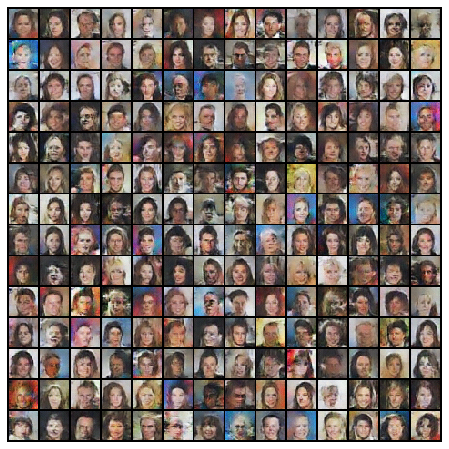

[ 2225/ 8000]	Loss_D: 0.5612	Loss_G: 3.2220	D(x): 0.8656	D(G(z)): 0.3219
[ 2250/ 8000]	Loss_D: 0.5340	Loss_G: 1.3307	D(x): 0.7188	D(G(z)): 0.1548
[ 2275/ 8000]	Loss_D: 0.6127	Loss_G: 1.5742	D(x): 0.7079	D(G(z)): 0.1969
[ 2300/ 8000]	Loss_D: 0.5884	Loss_G: 1.5042	D(x): 0.7074	D(G(z)): 0.1803


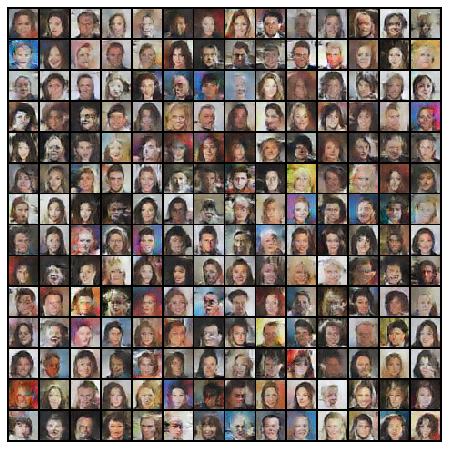

[ 2325/ 8000]	Loss_D: 0.6136	Loss_G: 2.1832	D(x): 0.8042	D(G(z)): 0.2967
[ 2350/ 8000]	Loss_D: 0.5496	Loss_G: 2.7704	D(x): 0.8645	D(G(z)): 0.3096
[ 2375/ 8000]	Loss_D: 0.9713	Loss_G: 1.4898	D(x): 0.4620	D(G(z)): 0.0748
[ 2400/ 8000]	Loss_D: 0.5629	Loss_G: 1.6933	D(x): 0.7625	D(G(z)): 0.2246


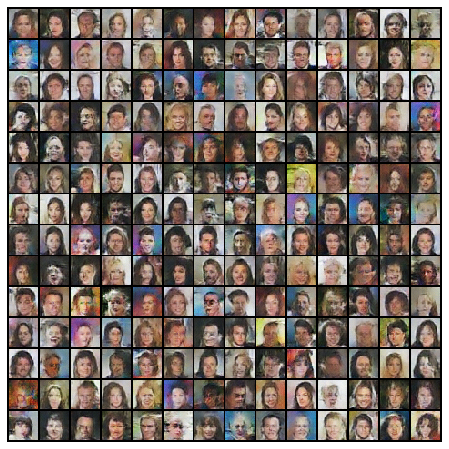

[ 2425/ 8000]	Loss_D: 0.6004	Loss_G: 1.3388	D(x): 0.7366	D(G(z)): 0.2172
[ 2450/ 8000]	Loss_D: 0.6334	Loss_G: 1.1867	D(x): 0.6714	D(G(z)): 0.1653
[ 2475/ 8000]	Loss_D: 1.0707	Loss_G: 0.6720	D(x): 0.4391	D(G(z)): 0.0996
[ 2500/ 8000]	Loss_D: 0.7624	Loss_G: 1.7882	D(x): 0.8307	D(G(z)): 0.3978


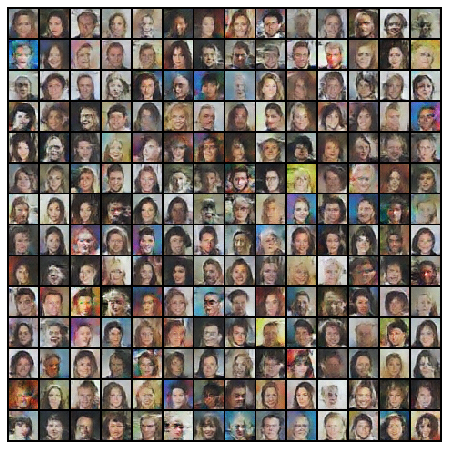

[ 2525/ 8000]	Loss_D: 0.7162	Loss_G: 1.4078	D(x): 0.6311	D(G(z)): 0.1682
[ 2550/ 8000]	Loss_D: 0.5201	Loss_G: 1.7886	D(x): 0.7989	D(G(z)): 0.2298
[ 2575/ 8000]	Loss_D: 0.5902	Loss_G: 3.0941	D(x): 0.8550	D(G(z)): 0.3234
[ 2600/ 8000]	Loss_D: 0.5498	Loss_G: 1.8179	D(x): 0.7550	D(G(z)): 0.2040


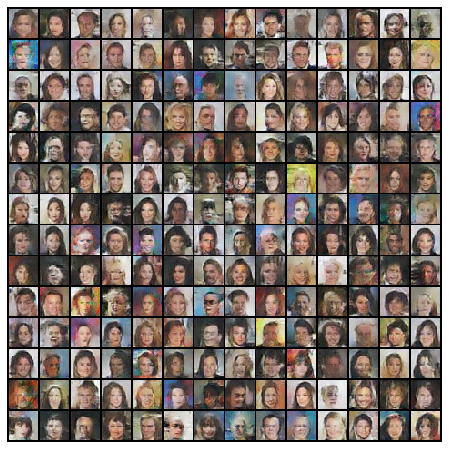

[ 2625/ 8000]	Loss_D: 0.5333	Loss_G: 2.2583	D(x): 0.8113	D(G(z)): 0.2497
[ 2650/ 8000]	Loss_D: 0.5097	Loss_G: 1.6894	D(x): 0.7811	D(G(z)): 0.2080
[ 2675/ 8000]	Loss_D: 0.4623	Loss_G: 2.1021	D(x): 0.8317	D(G(z)): 0.2178
[ 2700/ 8000]	Loss_D: 0.5039	Loss_G: 2.2011	D(x): 0.8294	D(G(z)): 0.2513


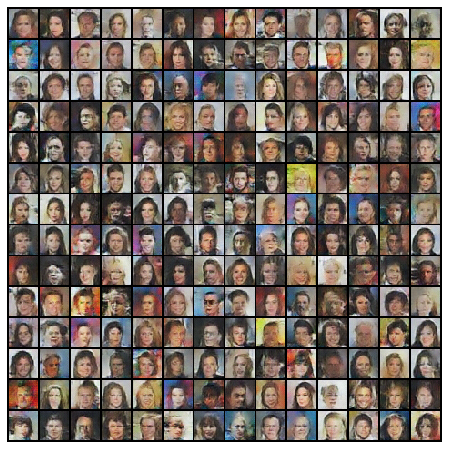

[ 2725/ 8000]	Loss_D: 0.7771	Loss_G: 2.4867	D(x): 0.8761	D(G(z)): 0.4377
[ 2750/ 8000]	Loss_D: 0.6001	Loss_G: 1.6087	D(x): 0.7494	D(G(z)): 0.2316
[ 2775/ 8000]	Loss_D: 0.6780	Loss_G: 2.6532	D(x): 0.8741	D(G(z)): 0.3883
[ 2800/ 8000]	Loss_D: 0.5357	Loss_G: 1.5469	D(x): 0.7348	D(G(z)): 0.1663


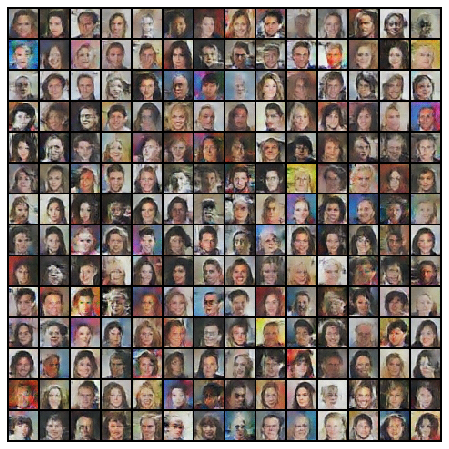

[ 2825/ 8000]	Loss_D: 0.5569	Loss_G: 2.4655	D(x): 0.8577	D(G(z)): 0.3074
[ 2850/ 8000]	Loss_D: 0.7531	Loss_G: 1.5766	D(x): 0.5524	D(G(z)): 0.0788
[ 2875/ 8000]	Loss_D: 0.5759	Loss_G: 1.7366	D(x): 0.7635	D(G(z)): 0.2288
[ 2900/ 8000]	Loss_D: 0.5512	Loss_G: 2.6365	D(x): 0.8593	D(G(z)): 0.3058


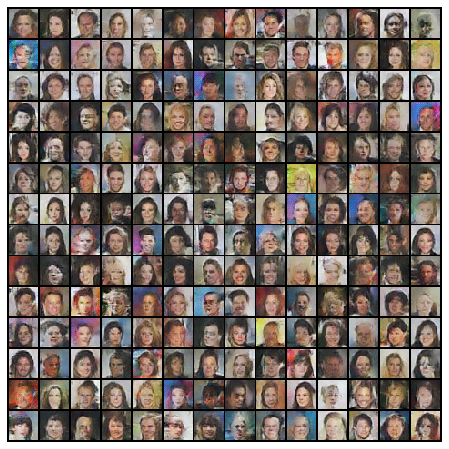

[ 2925/ 8000]	Loss_D: 0.6618	Loss_G: 1.9104	D(x): 0.8054	D(G(z)): 0.3179
[ 2950/ 8000]	Loss_D: 0.5405	Loss_G: 1.7046	D(x): 0.7894	D(G(z)): 0.2345
[ 2975/ 8000]	Loss_D: 0.4933	Loss_G: 1.6421	D(x): 0.7368	D(G(z)): 0.1438
[ 3000/ 8000]	Loss_D: 0.5494	Loss_G: 1.2209	D(x): 0.6785	D(G(z)): 0.1103


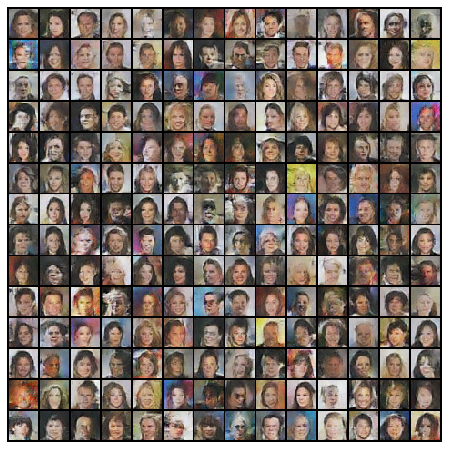

[ 3025/ 8000]	Loss_D: 0.5499	Loss_G: 1.9157	D(x): 0.7821	D(G(z)): 0.2357
[ 3050/ 8000]	Loss_D: 0.7393	Loss_G: 1.1481	D(x): 0.5996	D(G(z)): 0.1466
[ 3075/ 8000]	Loss_D: 0.4739	Loss_G: 2.3360	D(x): 0.8410	D(G(z)): 0.2377


In [0]:
for i in range(steps):
    
    ########
    # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    netG.requires_grad=False
    netD.requires_grad=True
    for _ in range(nb_update_D):
        netD.zero_grad()
        
        # Create batches
        x_real, y_real = get_batch_real()
        x_fake, y_fake = get_batch_fake()
        
        # Forward 
        y_hat_real = netD(x_real) # TODO
        y_hat_fake = netD(x_fake) # TODO
        errD =criterion(y_hat_real,y_real)+ criterion(y_hat_fake,y_fake)     # TODO sum of criterion of real and fake samples
        
        # Backward
        # TODO backward & optimization step on D
        errD.backward()
        optimizerD.step()

        # Compute / save metrics
        avg_output_for_real = y_hat_real.mean().item()
        avg_output_for_fake = y_hat_fake.mean().item()    
        D_losses.append(errD.item())



    ########
    # Update G network: maximize log(D(G(z)))
    netD.requires_grad=False
    netG.requires_grad=True
    for _ in range(nb_update_G):
        netG.zero_grad()
        x_fake, y_fake = get_batch_fake()
        y_real=torch.ones(y_fake.shape).to(device)
        y_hat_fake = netD(x_fake) 
        # TODO: forward + backward
        errG=criterion(y_hat_fake,y_real)
        # NOTE: use errG as name for your loss variable, like errD above
        errG.backward()
        optimizerG.step()
        # Compute / save metrics
        G_losses.append(errG.item())
        
    
    ########
    # Logs
    if i % 25 == 0:
        print('[%5d/%5d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
              % (i, steps, errD.item(), errG.item(), avg_output_for_real, avg_output_for_fake))

    if i % 100 == 0:
        with torch.no_grad():
            x_fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(x_fake, padding=2, normalize=True, nrow=14))
        plt.figure(figsize=(8,8))
        plt.imshow(np.transpose(img_list[-1],(1,2,0)))
        plt.axis("off")
        plt.show()

# Display training evolution

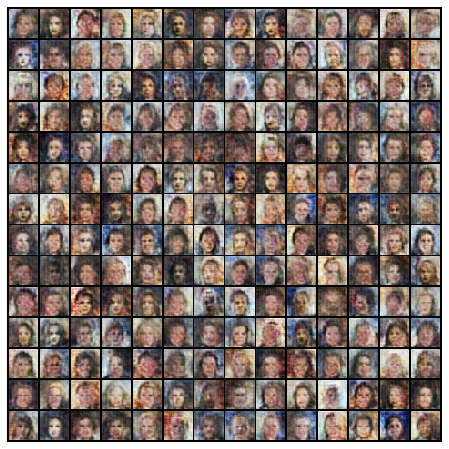

In [40]:
# Show generations
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

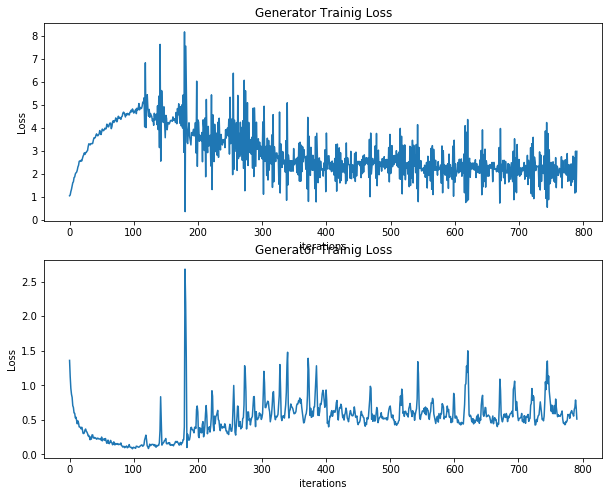

In [41]:
# Loss evolution
plt.figure(figsize=(10,8))
plt.subplot(2,1,1)
plt.title("Generator Trainig Loss")
plt.plot(G_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")

plt.subplot(2,1,2)
plt.title("Generator Trainig Loss")
plt.plot(D_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.show()